# Indian Number Plate YOLOv8 Train and Predict

In [1]:
#!rm -rf 

In [2]:
!pip install wandb==0.15.0
!wandb --version

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 21.4 MB/s eta 0:00:00
  Attempting uninstall: wandb
    Found existing installation: wandb 0.15.4
    Uninstalling wandb-0.15.4:
      Successfully uninstalled wandb-0.15.4
wandb, version 0.15.0


In [3]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 626.9/626.9 kB 9.3 MB/s eta 0:00:00


In [4]:
import os
import cv2
import random
import numpy as np
import pandas as pd
from tqdm import tqdm
import shutil
from shutil import copyfile
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')
from PIL import Image
import ultralytics
from ultralytics import YOLO
ultralytics.checks()

Ultralytics YOLOv8.0.131 🚀 Python-3.10.10 torch-2.0.0+cpu CPU
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 4813.6/8062.4 GB disk)


In [5]:
# Wandb login:
from kaggle_secrets import UserSecretsClient
import wandb
user_secrets = UserSecretsClient()
secret_value = user_secrets.get_secret("wandb_api_key")
wandb.login(key=secret_value)

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [6]:
!mkdir datasets
!mkdir datasets/train
!mkdir datasets/valid
!mkdir datasets/test

train_path='datasets/train/'
valid_path='datasets/valid/'
test_path='datasets/test/'

# Data Preparation

In [7]:
ano_paths=[]
for dirname, _, filenames in os.walk('/kaggle/input/indian-vehicle-number-plate-yolo-annotation/vid-1'):
    for filename in filenames:
        if filename[-4:]=='.txt':
            ano_paths+=[(os.path.join(dirname, filename))]
        
n=len(ano_paths) 
print(n)
N=list(range(n))
random.shuffle(N)

train_ratio = 0.6
valid_ratio = 0.2
test_ratio = 0.2

train_size = int(train_ratio*n)
valid_size = int(valid_ratio*n)

train_i = N[:train_size]
valid_i = N[train_size:train_size+valid_size]
test_i = N[train_size+valid_size:]

print(train_i)
print(valid_i)
print(test_i)

43
[20, 8, 25, 21, 1, 29, 38, 34, 11, 24, 0, 40, 32, 12, 35, 17, 5, 7, 10, 4, 23, 37, 16, 42, 22]
[2, 13, 14, 30, 27, 28, 15, 9]
[6, 19, 26, 18, 33, 31, 3, 36, 39, 41]


In [8]:
for i in train_i:
    ano_path=ano_paths[i]
    img_path=os.path.join('/kaggle/input/indian-vehicle-number-plate-yolo-annotation/vid-1',
                          ano_path.split('/')[-1][0:-4]+'.jpg')
    try:
        !cp {ano_path} {train_path}
        !cp {img_path} {train_path}
    except:
        continue
print(len(os.listdir(train_path)))

50


In [9]:
for i in valid_i:
    ano_path=ano_paths[i]
    img_path=os.path.join('/kaggle/input/indian-vehicle-number-plate-yolo-annotation/vid-1',
                          ano_path.split('/')[-1][0:-4]+'.jpg')
    try:
        !cp {ano_path} {valid_path}
        !cp {img_path} {valid_path}
    except:
        continue
print(len(os.listdir(valid_path)))

16


In [10]:
for i in test_i:
    ano_path=ano_paths[i]
    img_path=os.path.join('/kaggle/input/indian-vehicle-number-plate-yolo-annotation/vid-1',
                          ano_path.split('/')[-1][0:-4]+'.jpg')
    try:
        !cp {ano_path} {test_path}
        !cp {img_path} {test_path}
    except:
        continue
print(len(os.listdir(test_path)))      

20


# Create yaml file 

In [11]:
import yaml

data_yaml = dict(
    train ='train',
    val ='valid',
    test='test',
    nc =1,
    names =['Number Plate']
)

with open('data.yaml', 'w') as outfile:
    yaml.dump(data_yaml, outfile, default_flow_style=True)
    
%cat data.yaml

{names: [Number Plate], nc: 1, test: test, train: train, val: valid}


In [12]:
names =['Number Plate']
M=list(range(len(names)))
class_map=dict(zip(M,names))

# Train

In [13]:
model = YOLO("yolov8x.pt") 

100%|██████████| 131M/131M [00:03<00:00, 38.3MB/s]


In [14]:
!yolo task=detect mode=train model=yolov8x.pt data=data.yaml epochs=12 imgsz=480

Ultralytics YOLOv8.0.131 🚀 Python-3.10.10 torch-2.0.0+cpu CPU
yolo/engine/trainer: task=detect, mode=train, model=yolov8x.pt, data=data.yaml, epochs=12, patience=50, batch=16, imgsz=480, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dynamic=False, simplify=False, opset=None, worksp

# Result of Training

In [15]:
paths2=[]
for dirname, _, filenames in os.walk('/kaggle/working/runs/detect/train'):
    for filename in filenames:
        if filename[-4:]=='.jpg':
            paths2+=[(os.path.join(dirname, filename))]
paths2=sorted(paths2)

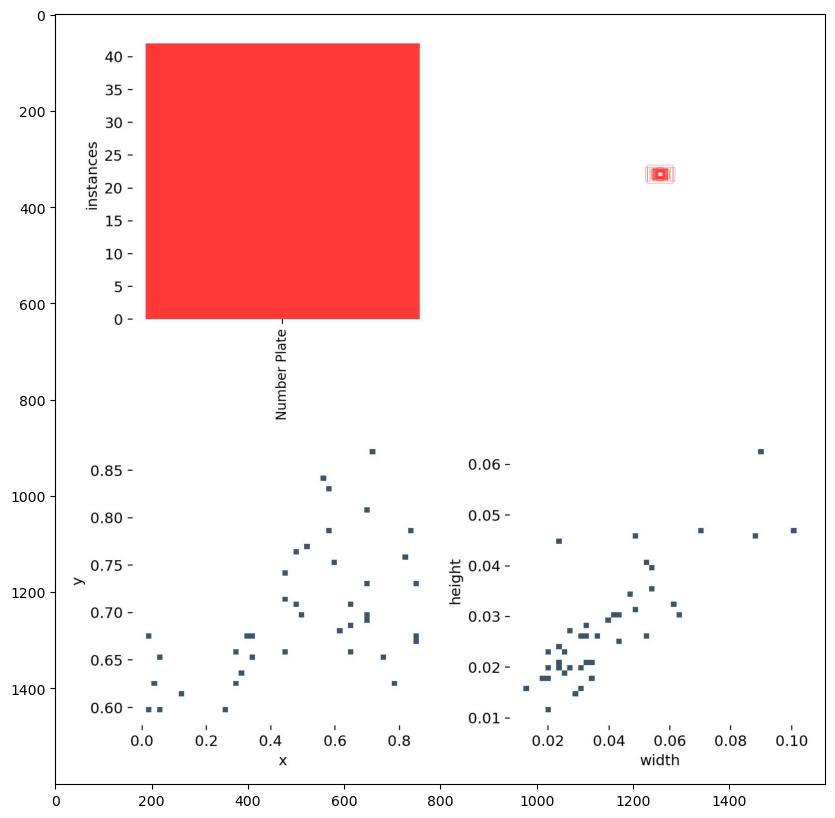

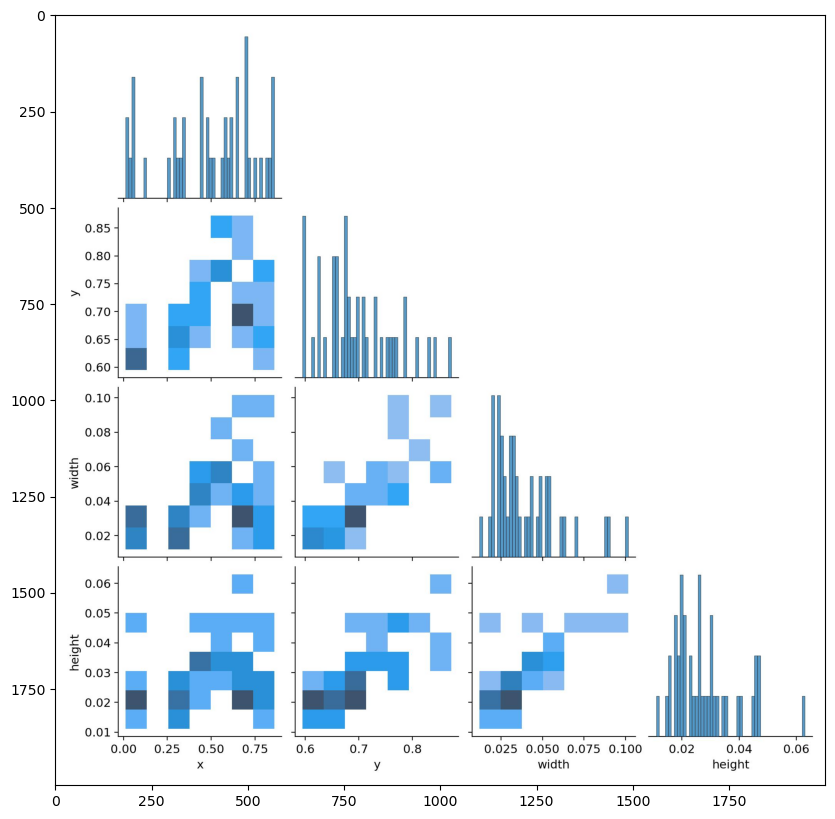

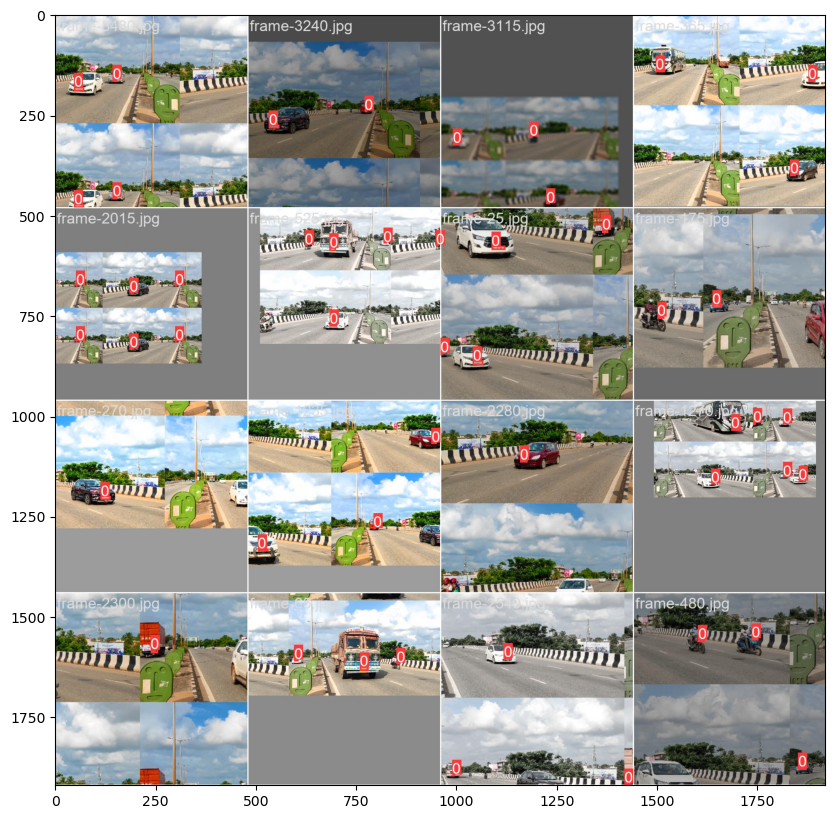

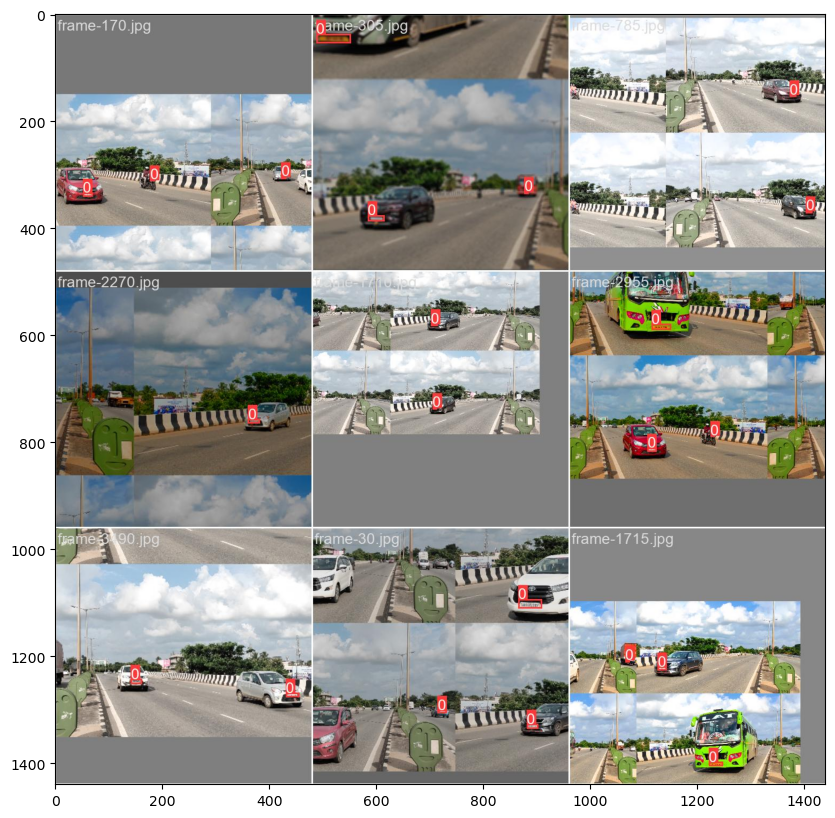

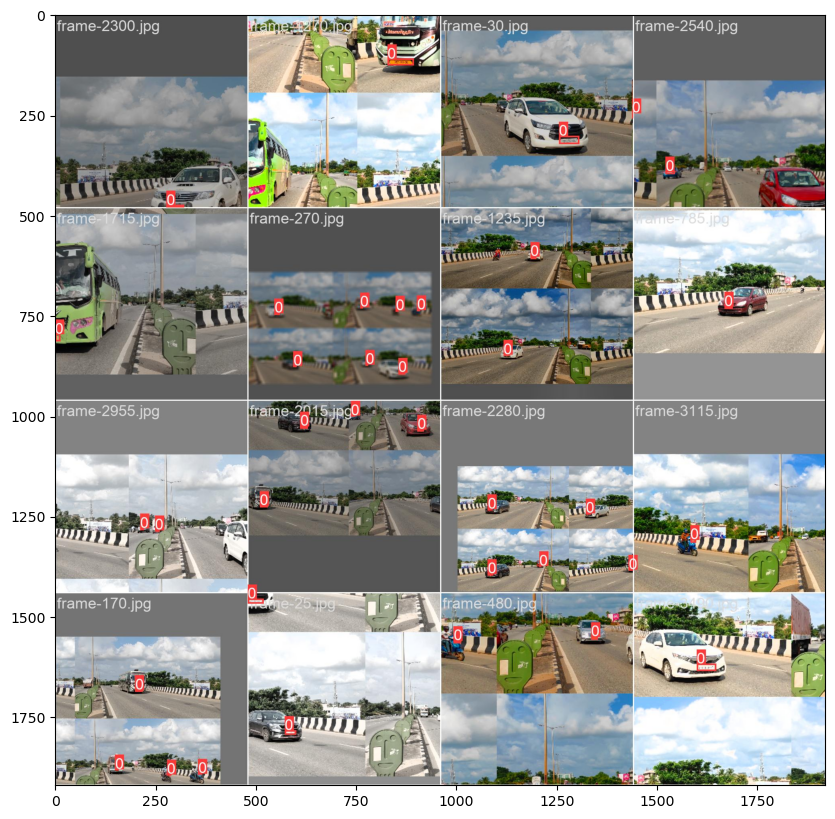

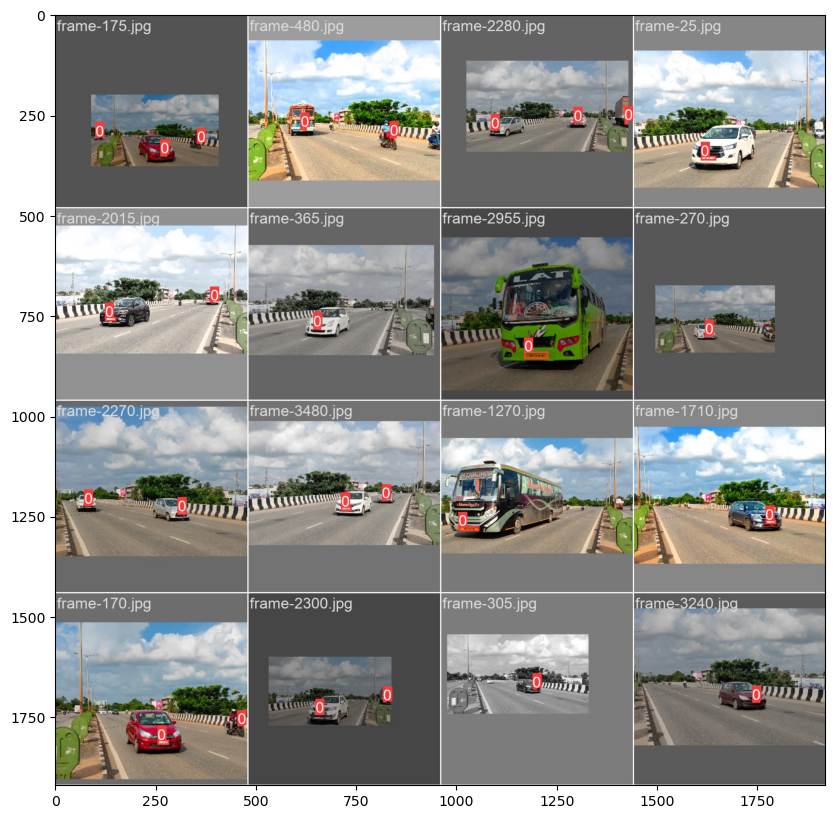

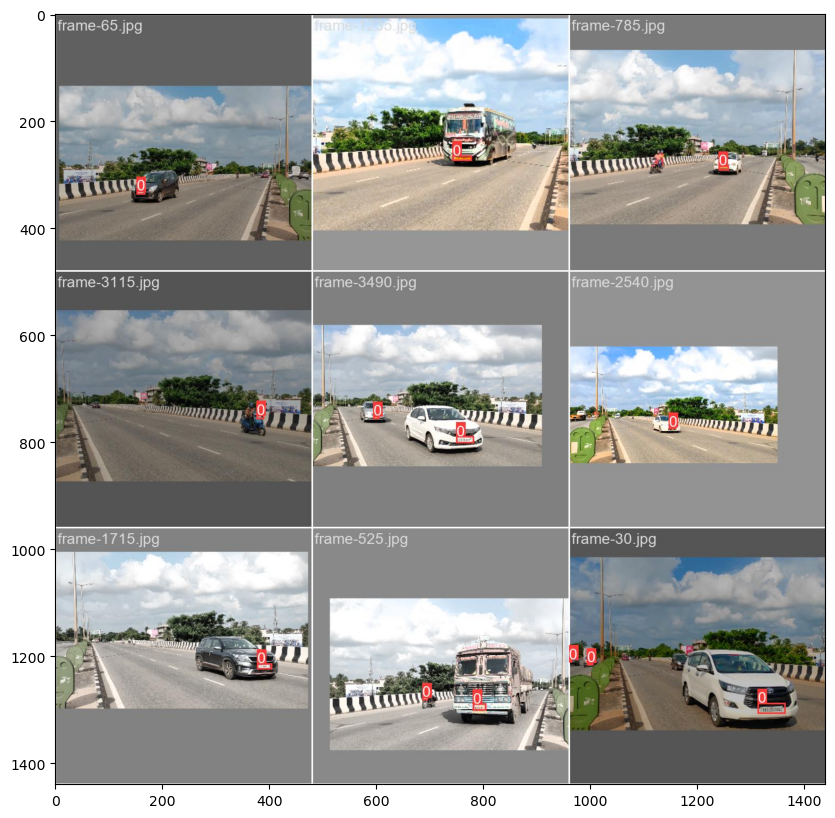

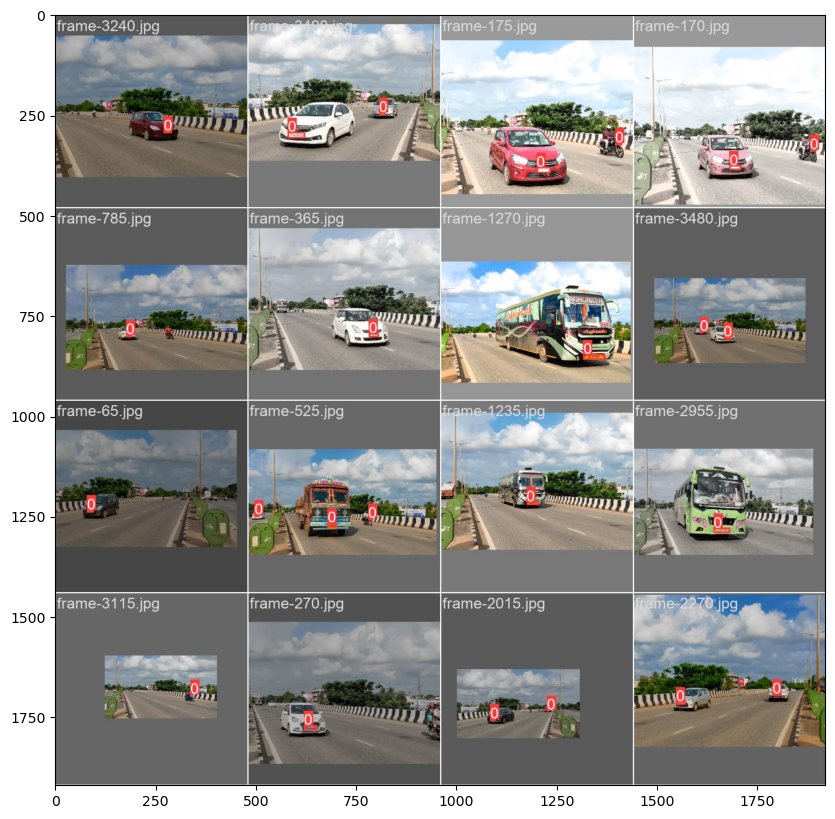

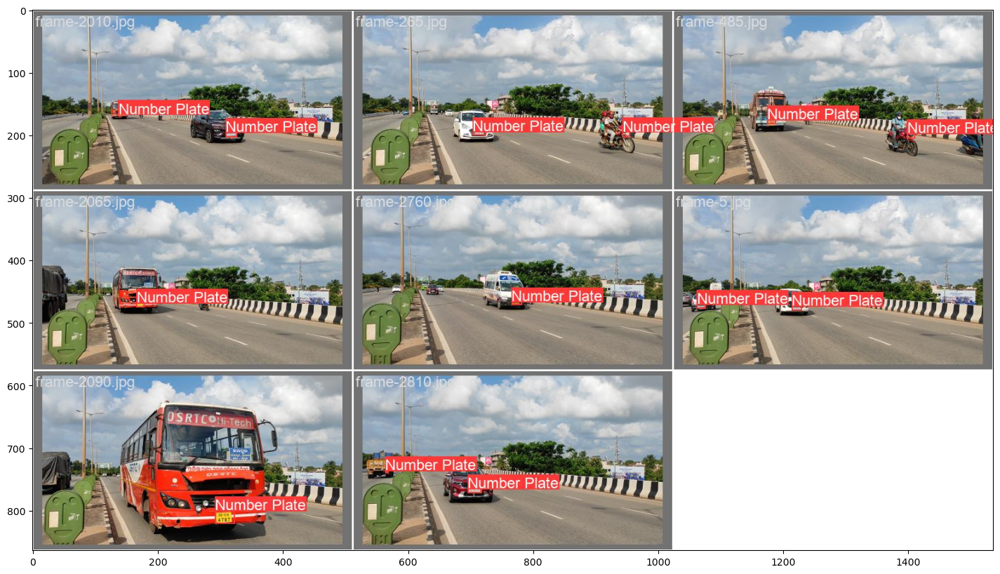

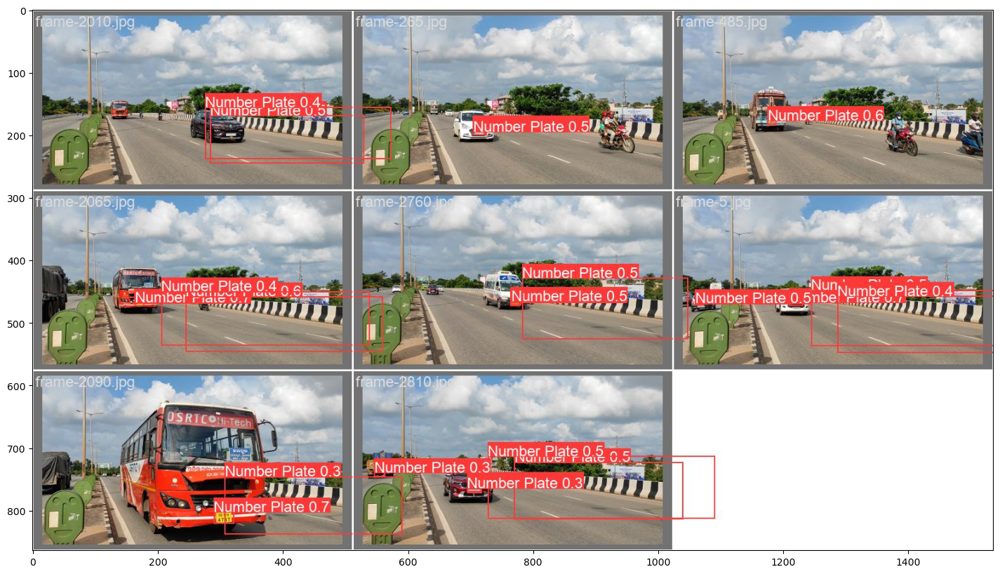

In [16]:
for path in paths2:
    image = Image.open(path)
    image=np.array(image)
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()

# Predict

In [17]:
best_path0='runs/detect/train/weights/best.pt'
source0='datasets/test'

In [18]:
ppaths=[]
for dirname, _, filenames in os.walk(source0):
    for filename in filenames:
        if filename[-4:]=='.jpg':
            ppaths+=[(os.path.join(dirname, filename))]
ppaths=sorted(ppaths)
print(ppaths[0])
print(len(ppaths))

datasets/test/frame-1240.jpg
10


In [19]:
model2 = YOLO(best_path0)

In [20]:
!yolo task=detect mode=predict model={best_path0} conf=0.7 source={source0}

/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so: undefined symbol: _ZTVN10tenso

# Result of Prediction

In [21]:
results = model2.predict(source0,conf=0.7)
print(len(results))

/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so: undefined symbol: _ZTVN10tenso

10


In [22]:
print((results[0].boxes.data))

tensor([[8.3833e+02, 6.9746e+02, 9.5038e+02, 7.3659e+02, 9.3413e-01, 0.0000e+00],
        [8.3618e+02, 6.8466e+02, 9.4146e+02, 7.1123e+02, 7.5061e-01, 0.0000e+00]])


In [23]:
PBOX=pd.DataFrame(columns=range(6))
for i in range(len(results)):
    arri=pd.DataFrame(results[i].boxes.data.cpu().numpy()).astype(float)
    path=ppaths[i]
    file=path.split('/')[-1]
    arri=arri.assign(file=file)
    arri=arri.assign(i=i)
    PBOX=pd.concat([PBOX,arri],axis=0)
PBOX.columns=['x','y','x2','y2','confidence','class','file','i']
display(PBOX)

,x,y,x2,y2,confidence,class,file,i
0,838.332153,697.464600,950.377563,736.588867,0.934128,0.0,frame-1240.jpg,0.0
1,836.178833,684.658813,941.459961,711.232056,0.750612,0.0,frame-1240.jpg,0.0
0,1154.566406,707.957336,1230.098633,735.252014,0.784362,0.0,frame-1705.jpg,1.0
0,1196.554443,813.291199,1284.103760,834.803650,0.860720,0.0,frame-2550.jpg,2.0
0,1230.044678,783.746887,1315.211426,826.719055,0.979281,0.0,frame-2855.jpg,4.0
0,1527.855347,781.631531,1617.936401,814.219666,0.968460,0.0,frame-315.jpg,6.0
1,565.804810,621.639160,620.707764,643.561890,0.825613,0.0,frame-315.jpg,6.0
2,1414.486938,811.354370,1472.006226,838.590820,0.707524,0.0,frame-315.jpg,6.0
0,843.530640,780.924683,916.160278,812.675171,0.943338,0.0,frame-3505.jpg,7.0
0,1008.539612,855.564453,1123.029785,899.495117,0.991297,0.0,frame-3510.jpg,8.0


In [24]:
PBOX['class']=PBOX['class'].apply(lambda x: class_map[int(x)])
PBOX=PBOX.reset_index(drop=True)
display(PBOX)
display(PBOX['class'].value_counts())

,x,y,x2,y2,confidence,class,file,i
0,838.332153,697.464600,950.377563,736.588867,0.934128,Number Plate,frame-1240.jpg,0.0
1,836.178833,684.658813,941.459961,711.232056,0.750612,Number Plate,frame-1240.jpg,0.0
2,1154.566406,707.957336,1230.098633,735.252014,0.784362,Number Plate,frame-1705.jpg,1.0
3,1196.554443,813.291199,1284.103760,834.803650,0.860720,Number Plate,frame-2550.jpg,2.0
4,1230.044678,783.746887,1315.211426,826.719055,0.979281,Number Plate,frame-2855.jpg,4.0
5,1527.855347,781.631531,1617.936401,814.219666,0.968460,Number Plate,frame-315.jpg,6.0
6,565.804810,621.639160,620.707764,643.561890,0.825613,Number Plate,frame-315.jpg,6.0
7,1414.486938,811.354370,1472.006226,838.590820,0.707524,Number Plate,frame-315.jpg,6.0
8,843.530640,780.924683,916.160278,812.675171,0.943338,Number Plate,frame-3505.jpg,7.0
9,1008.539612,855.564453,1123.029785,899.495117,0.991297,Number Plate,frame-3510.jpg,8.0


Number Plate    13
Name: class, dtype: int64

In [25]:
def draw_box2(n0):
    
    ipath=ppaths[n0]
    image=cv2.imread(ipath)
    H,W=image.shape[0],image.shape[1]
    file=ipath.split('/')[-1]
    
    if PBOX[PBOX['file']==file] is not None:
        box=PBOX[PBOX['file']==file]
        box=box.reset_index(drop=True)
        #display(box)

        for i in range(len(box)):
            label=box.loc[i,'class']
            x=int(box.loc[i,'x'])
            y=int(box.loc[i,'y'])
            x2=int(box.loc[i,'x2']) 
            y2=int(box.loc[i,'y2'])
            #print(label,x,y,x2,y2)
            #cv2.putText(image, f'{label}', (x, int(y-4)), 
            #            cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0,255,0),2)
            cv2.rectangle(image,(x,y),(x2,y2),(0,255,0),3) #green
    
    #plt.imshow(image)
    #plt.show()   
    
    return image

In [26]:
def create_animation(ims):
    fig=plt.figure(figsize=(12,8))
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    text = plt.text(0.05, 0.05, f'Slide {0}', transform=fig.transFigure, fontsize=14, color='blue')
    plt.axis('off')
    plt.close()

    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        text.set_text(f'Slide {i}')        
        return [im]    
    
    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000)

In [27]:
images2=[]
for i in tqdm(range(len(ppaths))):
    images2+=[draw_box2(i)]

100%|██████████| 10/10 [00:00<00:00, 27.51it/s]


In [28]:
create_animation(images2)